复现结果：
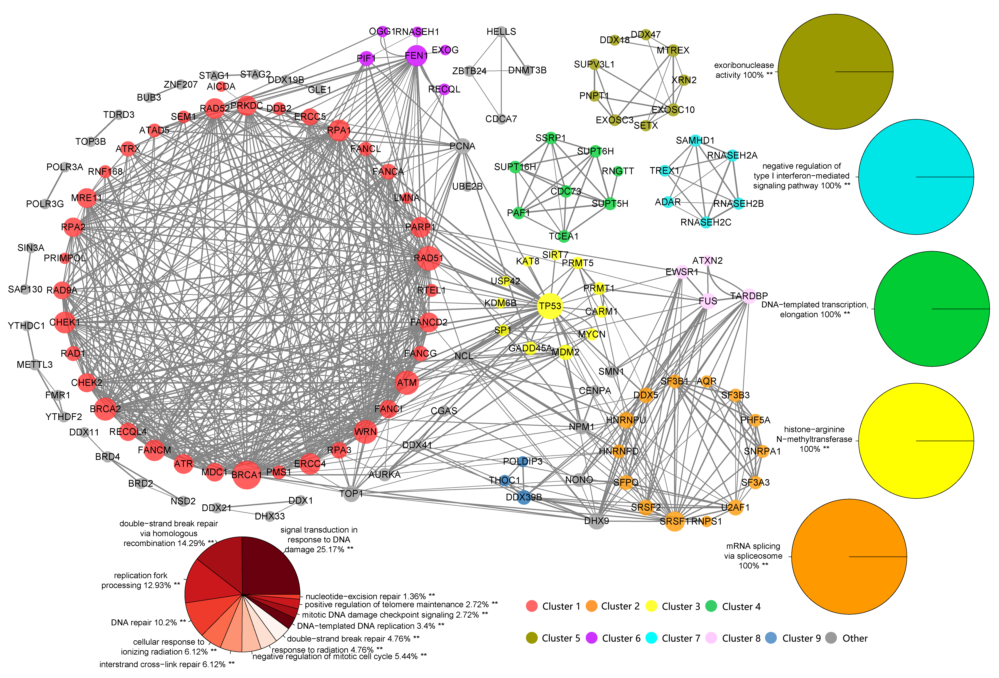

### 1 数据获取

借助 [STRING](https://string-db.org/)获得Gene list中各个蛋白间的互作图和表(根据文章，选择高质信度（>0.7）的互作数据):

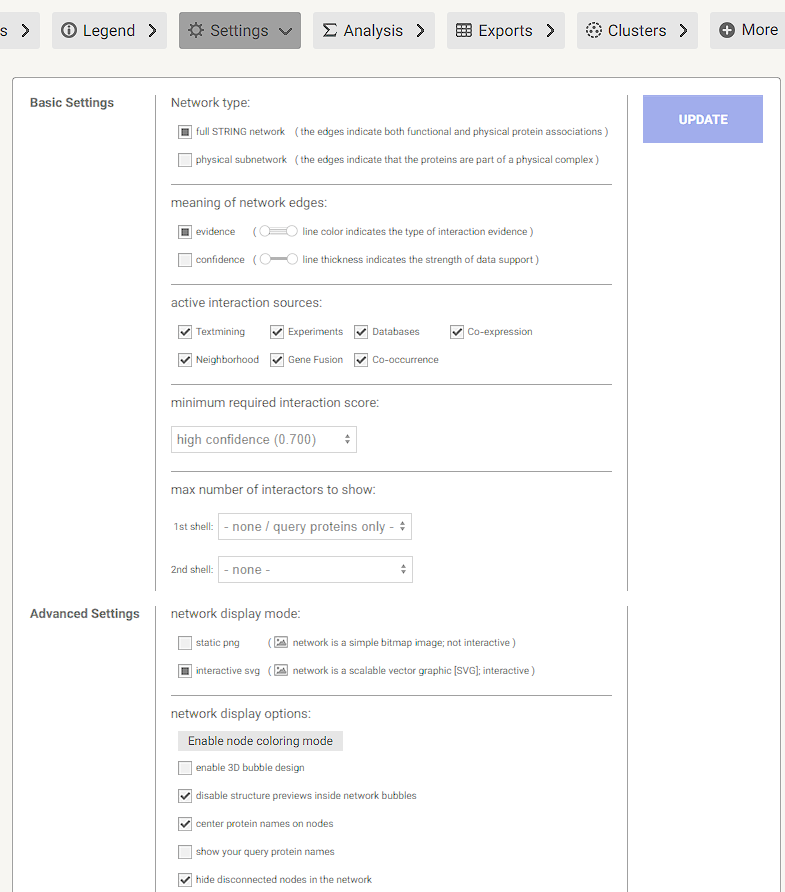

可利用STRING进行部分互作分析，如富集分析、聚类等：

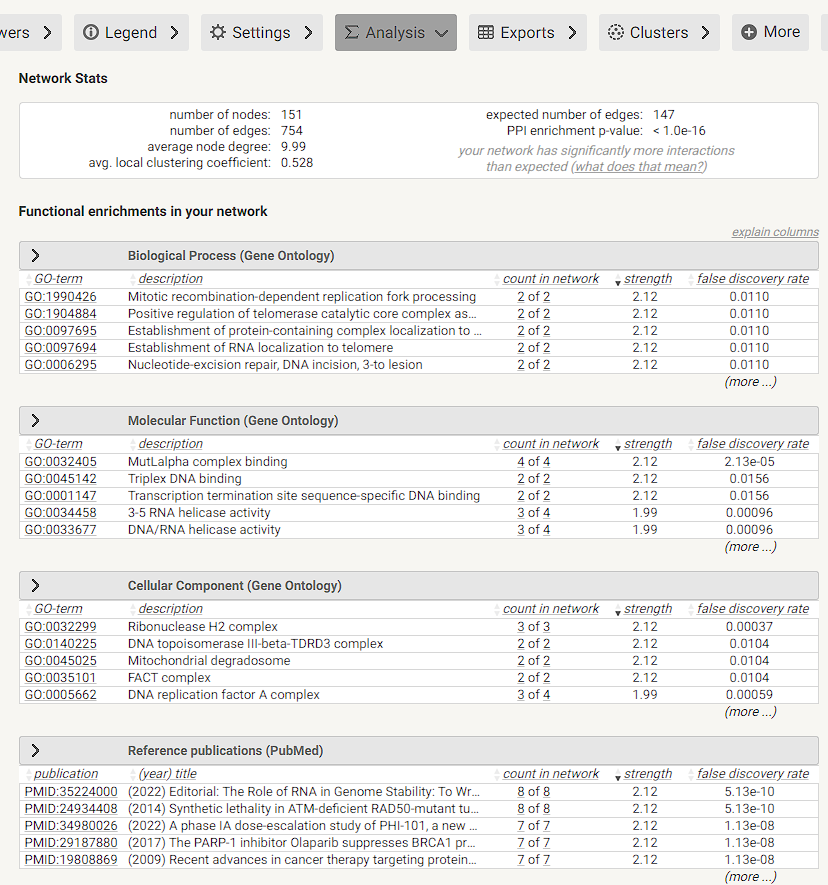

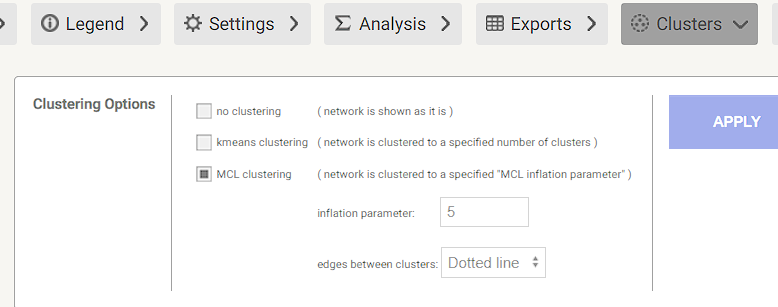

>MCL聚类的一个重要参数是inflation(R)。一般的，随着R(inflation)的增大，其粒度将减小，如下所示。
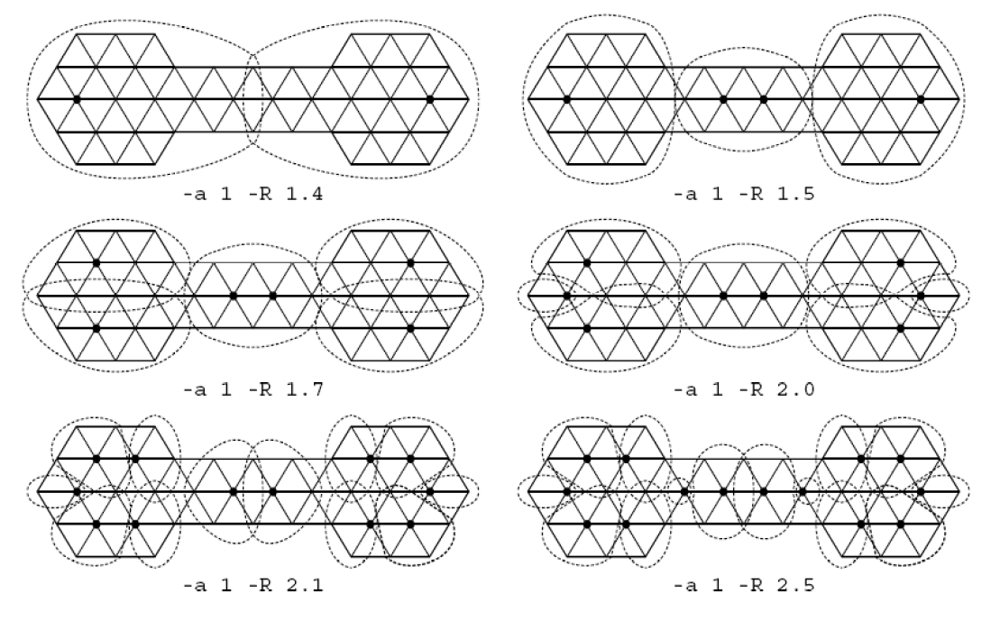

聚类结果如下：

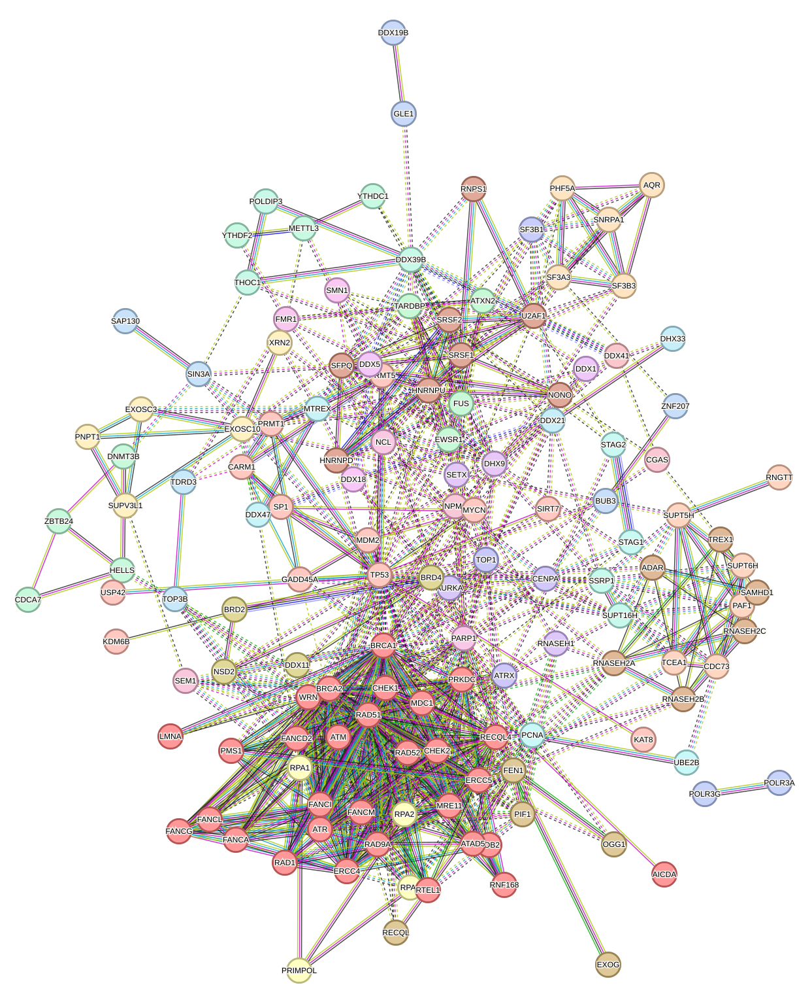

还可以选择某一个cluster单独呈现互作网络，如下：
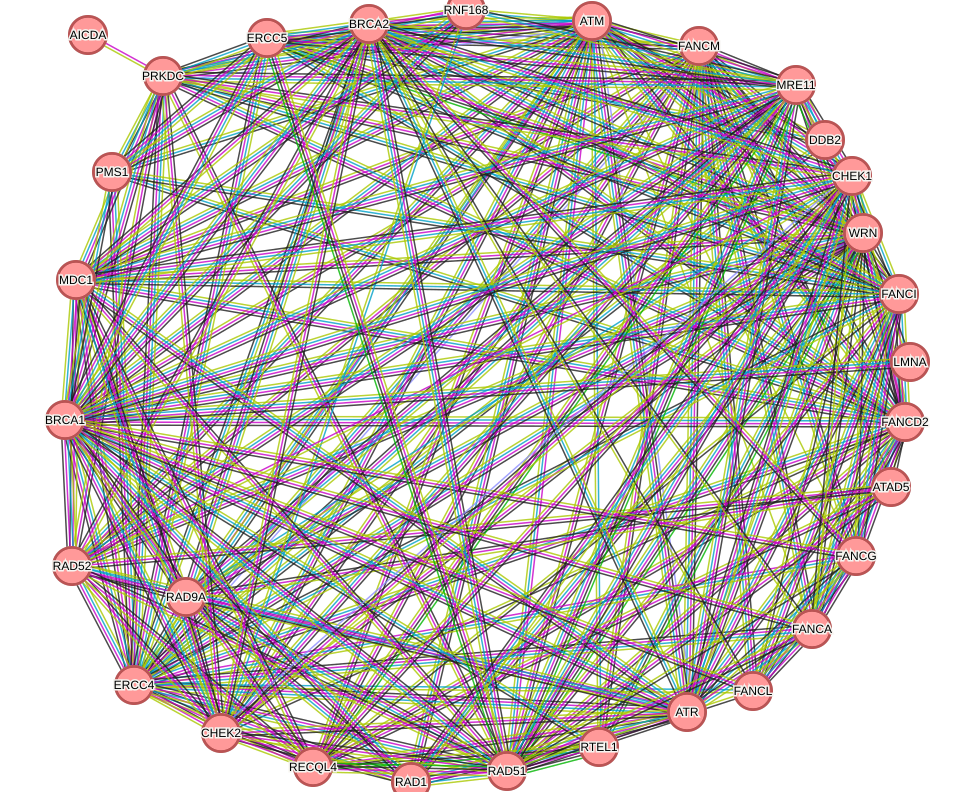

### 2. AutoAnnotate聚类

#### 2.1 Cytoscape初调

将STING数据以tsv格式导出，并导入Cytoscape，如下：

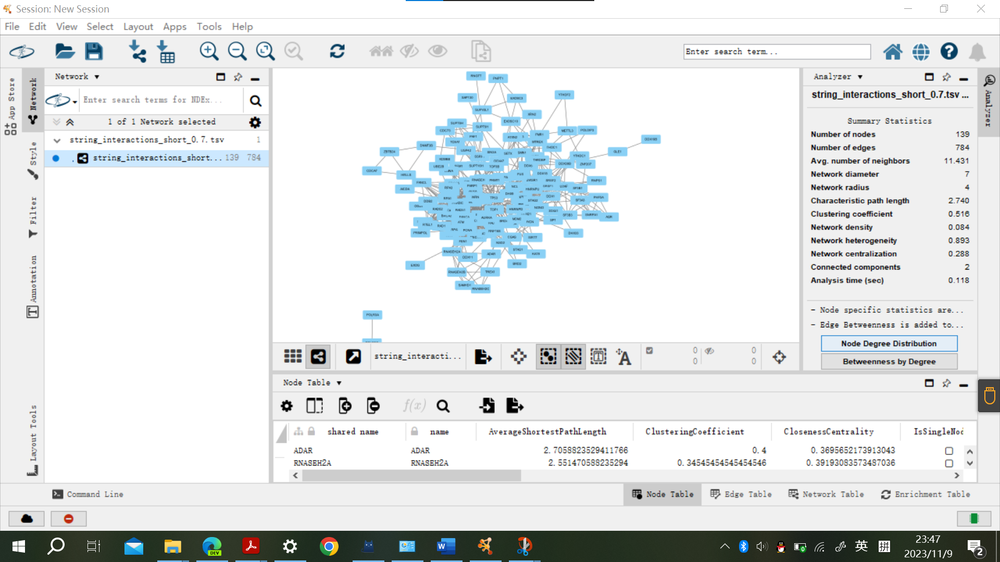

新建风格PPI-Rloop：

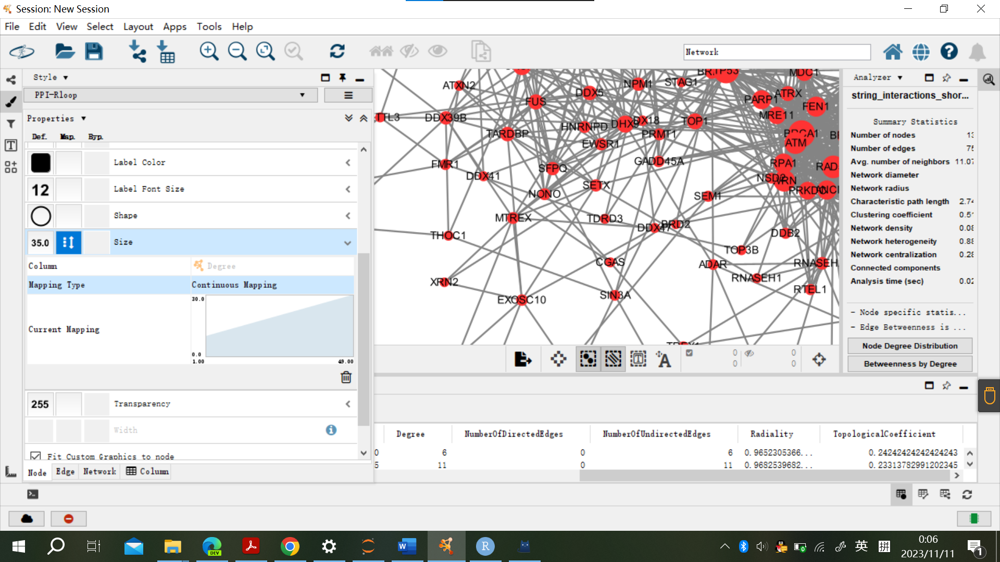

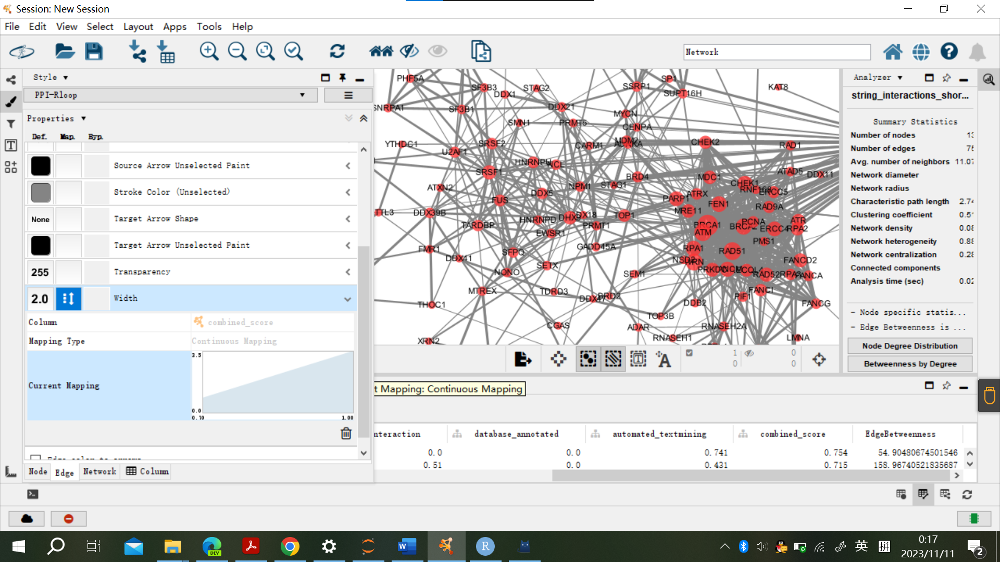

#### 2.2 AutoAnnotate简单聚类

使用AutoAnnotate的MCL聚类结果如下，可见结点集中分布在rnaseh2c类群（106/138），其他cluster很少，说明AutoAnnotate默认的MCL聚类参数设置（AutoAnnotate:Creation Parameters窗口）有问题，聚类结果不好。

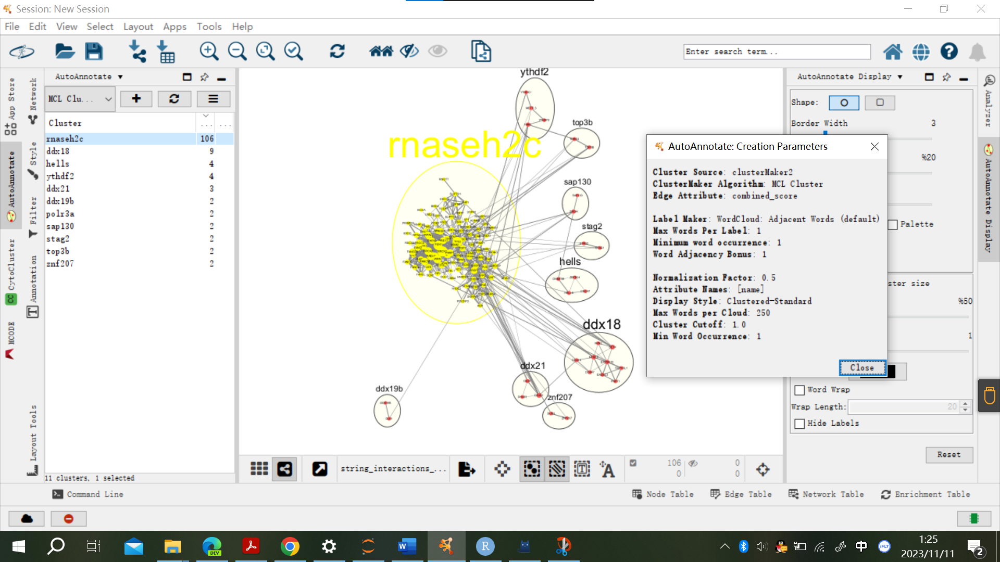

#### 2.3 手动设置MCL聚类

因此，通过```Apps -> ClusterMaker cluster Network -> MCL cluster```手动设置MCL的聚类参数，如下图所示。

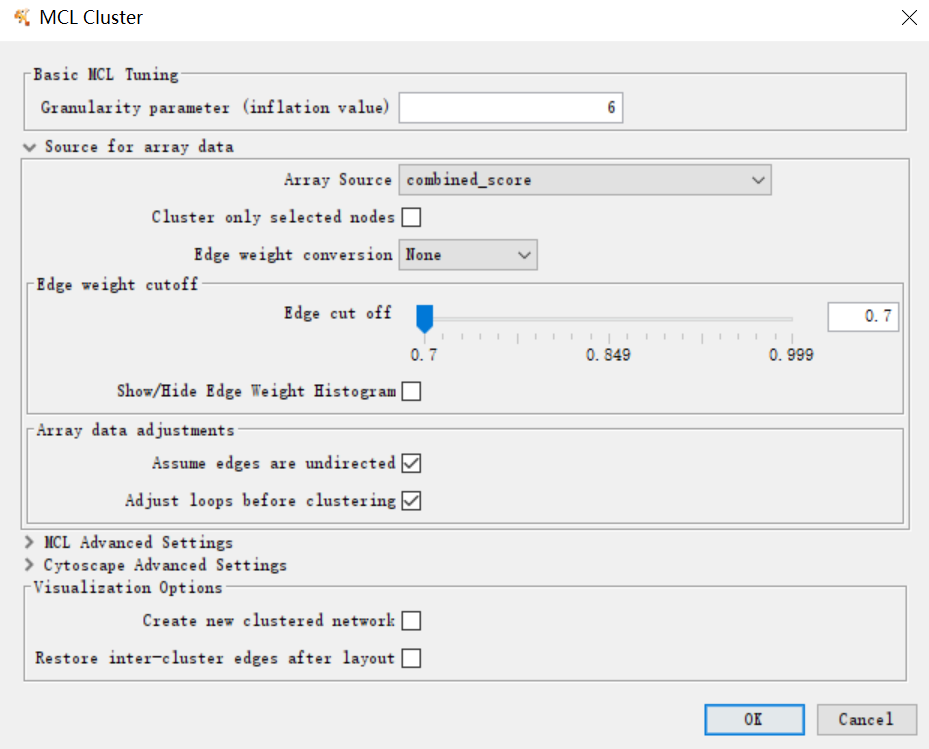

手动设置的MCL聚类结果如下。可见，含6个及以上结点数的cluster有7个，10个以上结点数的有3个，聚类结果较好，与文章原图接近。

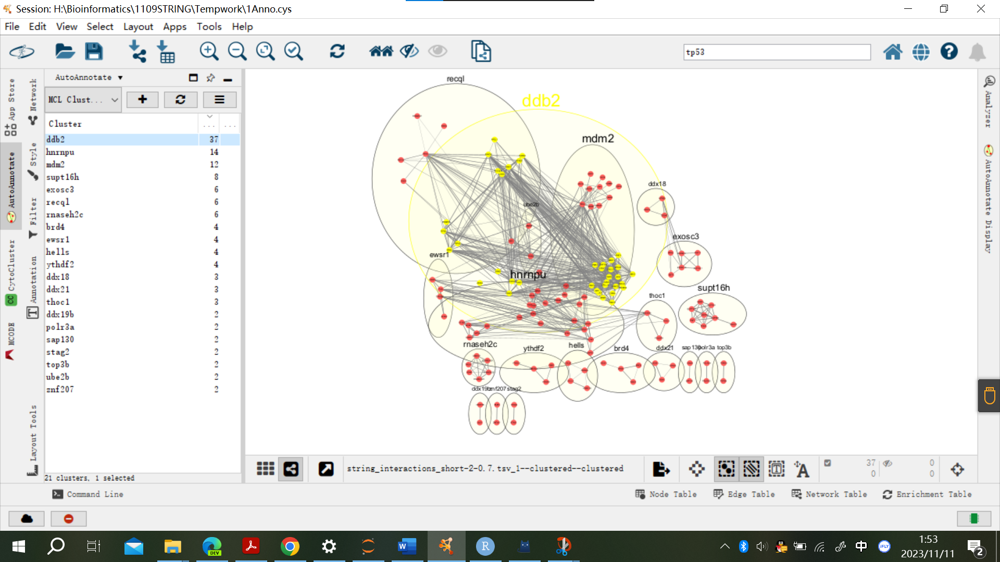

调整各cluster的位置，并根据文章原图设置对应色彩（cluster1-7与原文一致，cluster8和9是新增的），得到如下聚类图：
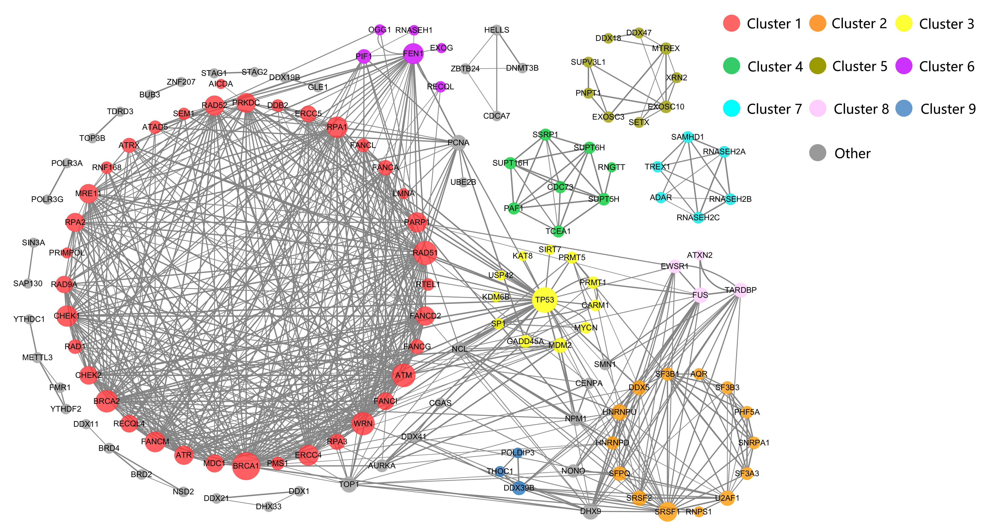

### 3. GO富集分析

#### 3.1 ClueGO参数设置

首先将每一个cluster所包含的基因复制到ClueGO的输入框，并设置各cluster色彩与前文一致，如下：

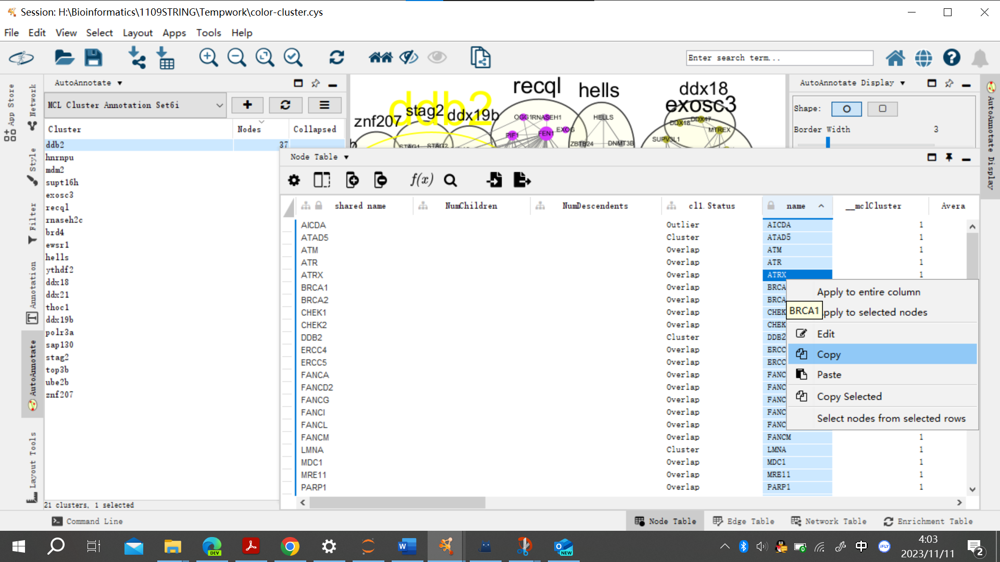

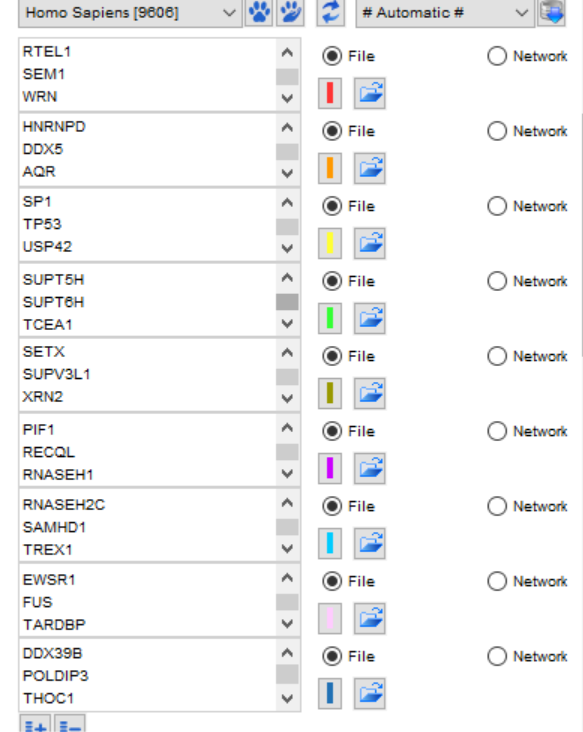


可视化风格选择“Clusters”（其详细描述如下），并按照原文设置通路展示的阈值为0.01：

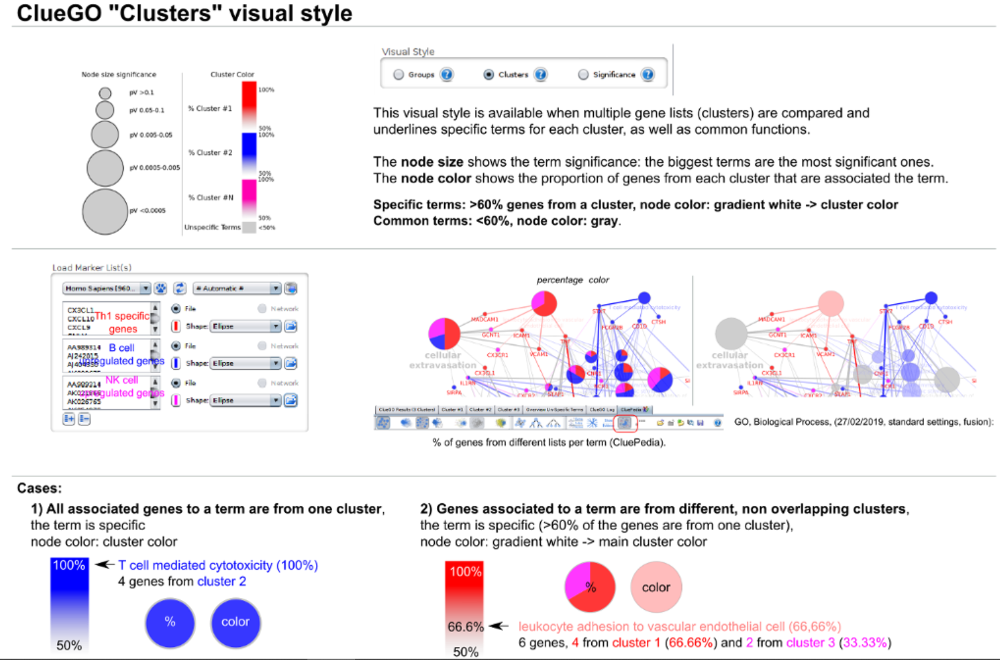


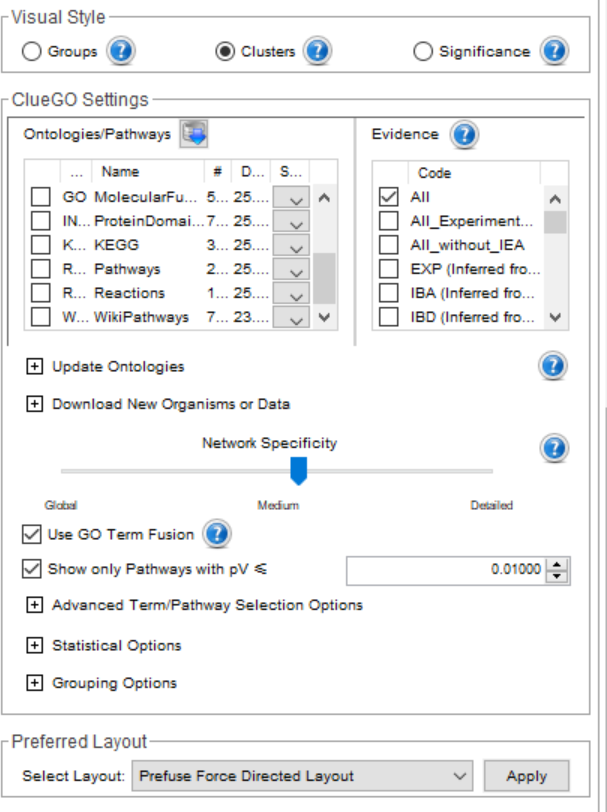

#### 3.2 通路富集分析结果
得到的富集结果的网络图如下。其中，每个节点是代表性富集通路，节点的连线表示通路之间的共有的基因数，颜色表示该节点的富集情况分类，详细的富集通路结果在ClueGO results中可以看到。

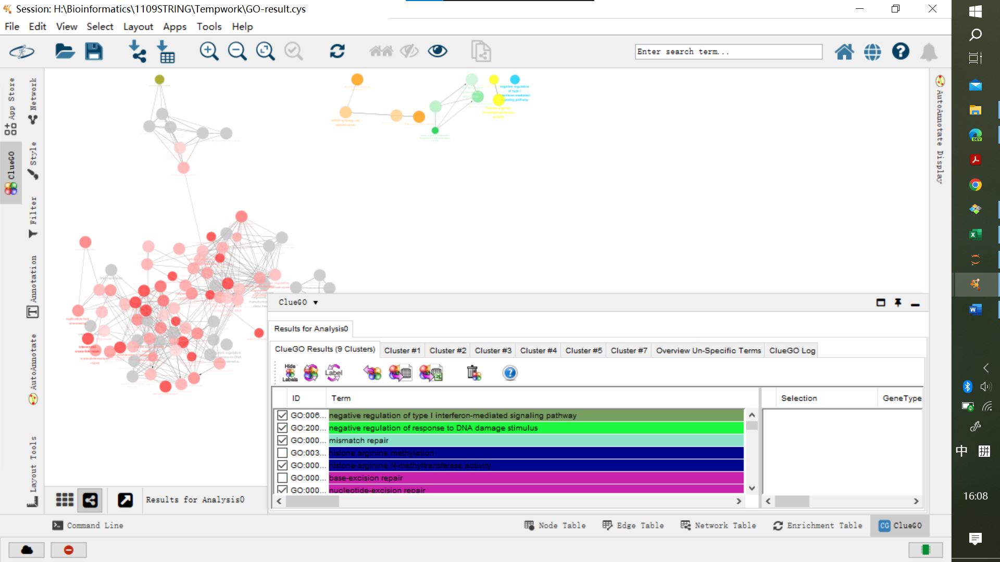

其中```ClueGO Results(9 Clusters)```是所有的9组clusters共同的通路富集结果，后面的```Cluster #1```等是每个Cluster单独的富集结果。该结果中没有Cluster 6和8，可能是因为这两个Cluster没有特异性富集通路（pV > 0.01）。

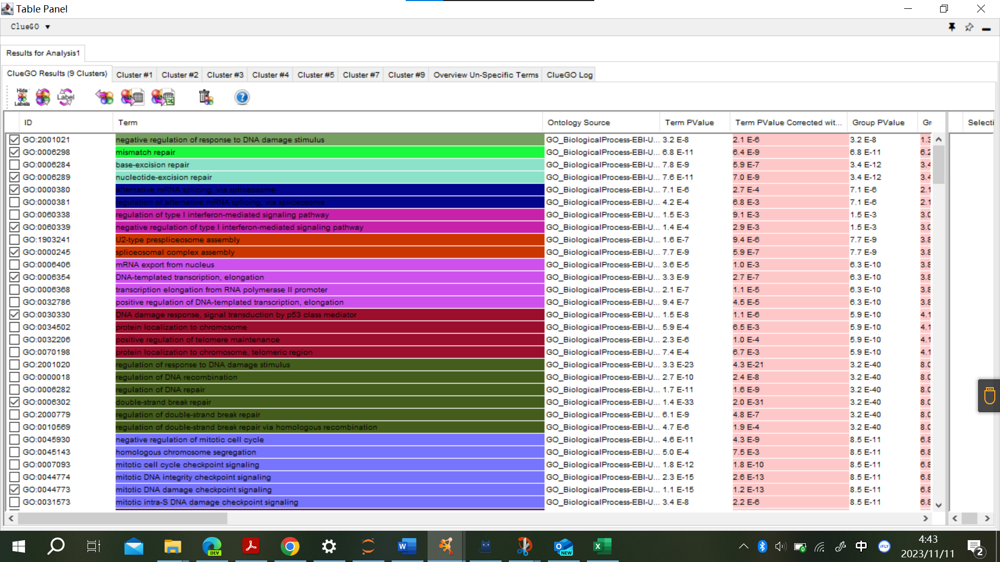

各组富集分析结果中，条形图的bars代表和某个GOterm相关的gene数目，右边标注了相应数目和显著度。最后的饼图展示了该cluster中每个GOterm的基因百分比情况。
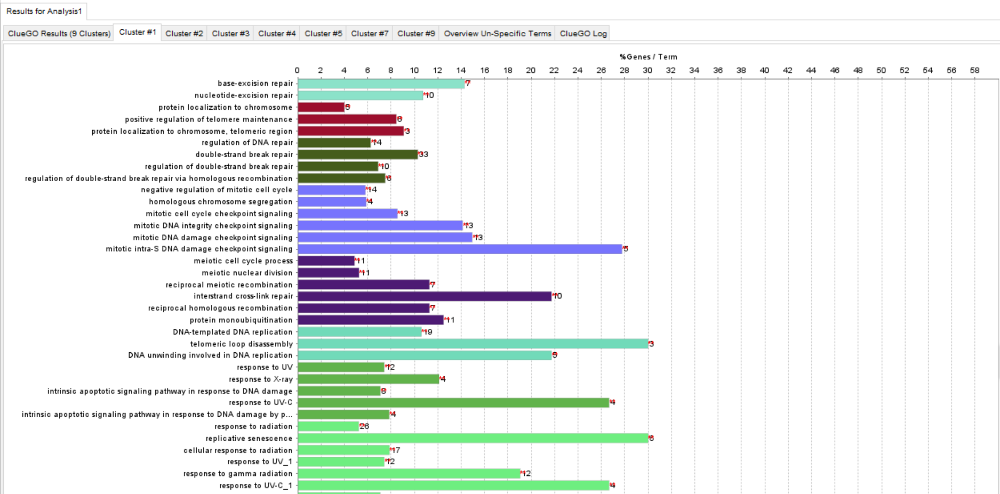

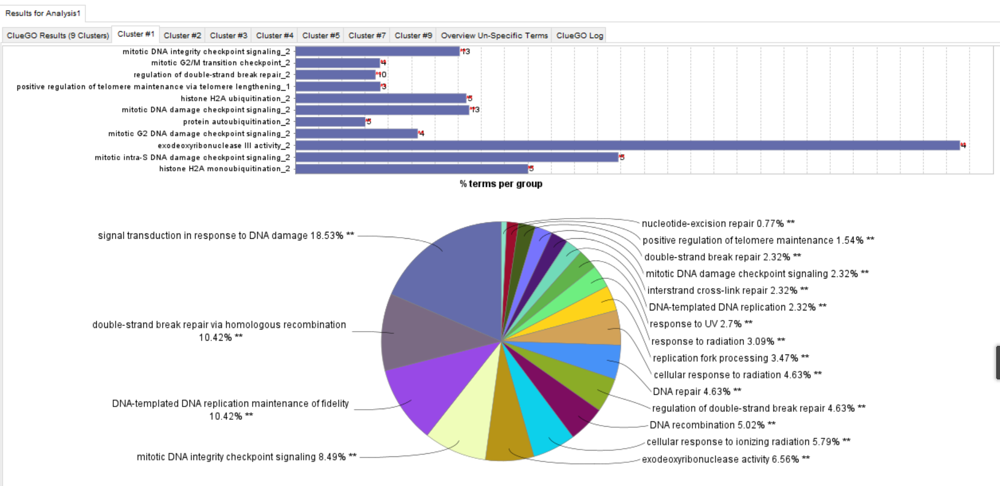

可见Cluster1的基因富集的通路比较多，而其他的clusters富集的通路则比较专一，如下：
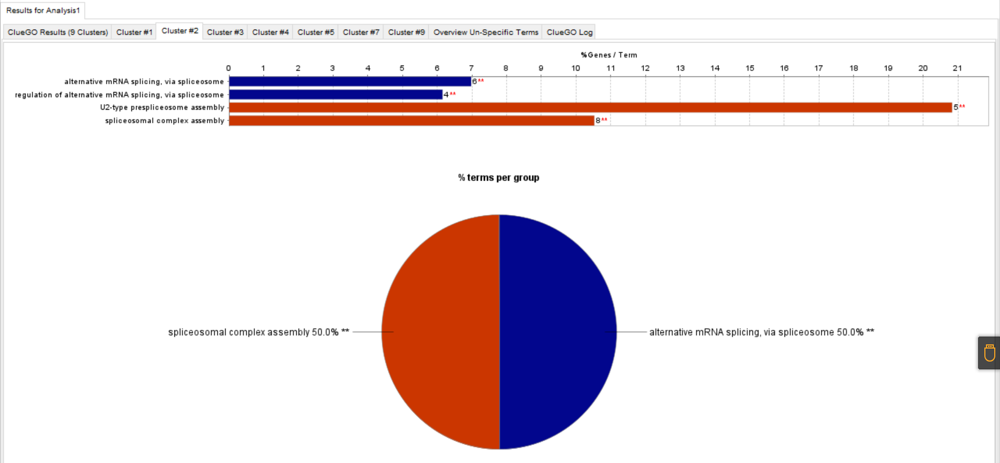

#### 3.3 R重绘富集分析结果
ClueGO给出的各组富集分析结果饼图色彩与原文设置不一致，使用R进行重绘。

In [1]:
library(ggplot2)

In [13]:
#结果录入
cluster1 <- data.frame(c('signal transduction in response to DNA damage', 'double-strand break repair via homologous recombination','replication fork processing','DNA repair','cellular response to ionizing radiation','interstrand cross-link repair','negative regulation of mitotic cell cycle','response to radiation','double-strand break repair','DNA-templated DNA replication','mitotic DNA damage checkpoint signaling','positive regulation of telomere maintenance','nucleotide-excision repair'),
                      c(25.17, 14.29,12.93,10.2,6.12,6.12,5.44,4.76,4.76,3.4,2.72,2.72,1.36))
colnames(cluster1)<-c('GO:BP','Percent(%)')
print("Cluster1")
cluster1

cluster2 <- data.frame('mRNA splicing via spliceosome',100)
colnames(cluster2)<-c('GO:BP','Percent(%)')
print("Cluster2")
cluster2

cluster3 <- data.frame('histone-arginine N-methyltransferase',100)
colnames(cluster3)<-c('GO:BP','Percent(%)')
print("Cluster3")
cluster3

cluster4 <- data.frame('DNA-templated transcription, elongation',100)
colnames(cluster4)<-c('GO:BP','Percent(%)')
print("Cluster4")
cluster4

cluster5 <- data.frame('exoribonuclease activity',100)
colnames(cluster5)<-c('GO:BP','Percent(%)')
print("Cluster5")
cluster5

cluster7 <- data.frame('negative regulation of type I interferon-mediated signaling pathway',100)
colnames(cluster7)<-c('GO:BP','Percent(%)')
print("Cluster7")
cluster7

[1] "Cluster1"


GO:BP,Percent(%)
<chr>,<dbl>
signal transduction in response to DNA damage,25.17
double-strand break repair via homologous recombination,14.29
replication fork processing,12.93
DNA repair,10.20
cellular response to ionizing radiation,6.12
interstrand cross-link repair,6.12
negative regulation of mitotic cell cycle,5.44
response to radiation,4.76
double-strand break repair,4.76


[1] "Cluster2"


GO:BP,Percent(%)
<chr>,<dbl>
mRNA splicing via spliceosome,100


[1] "Cluster3"


GO:BP,Percent(%)
<chr>,<dbl>
histone-arginine N-methyltransferase,100


[1] "Cluster4"


GO:BP,Percent(%)
<chr>,<dbl>
"DNA-templated transcription, elongation",100


[1] "Cluster5"


GO:BP,Percent(%)
<chr>,<dbl>
exoribonuclease activity,100


[1] "Cluster7"


GO:BP,Percent(%)
<chr>,<dbl>
negative regulation of type I interferon-mediated signaling pathway,100


Warning message in brewer.pal(13, "Reds"):
"n too large, allowed maximum for palette Reds is 9
Returning the palette you asked for with that many colors
"


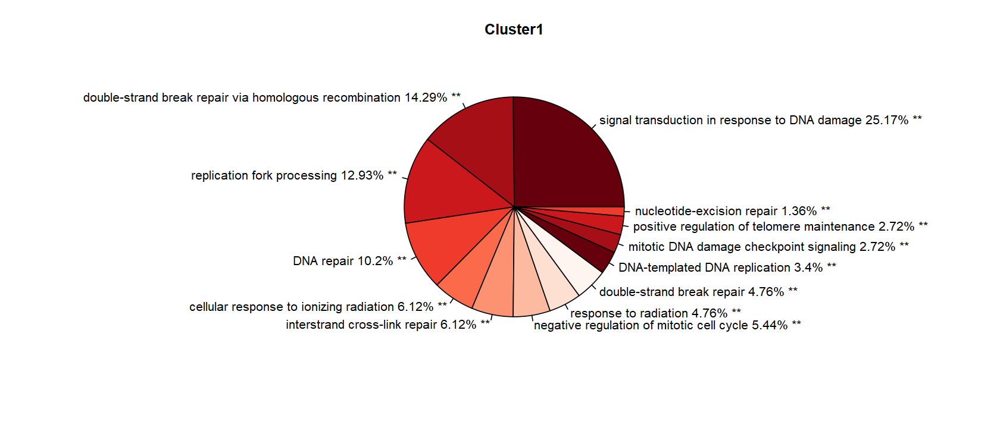

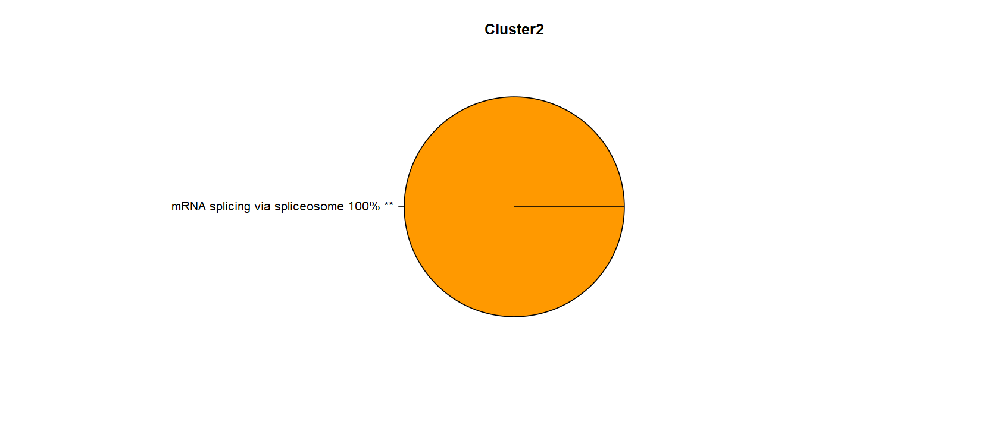

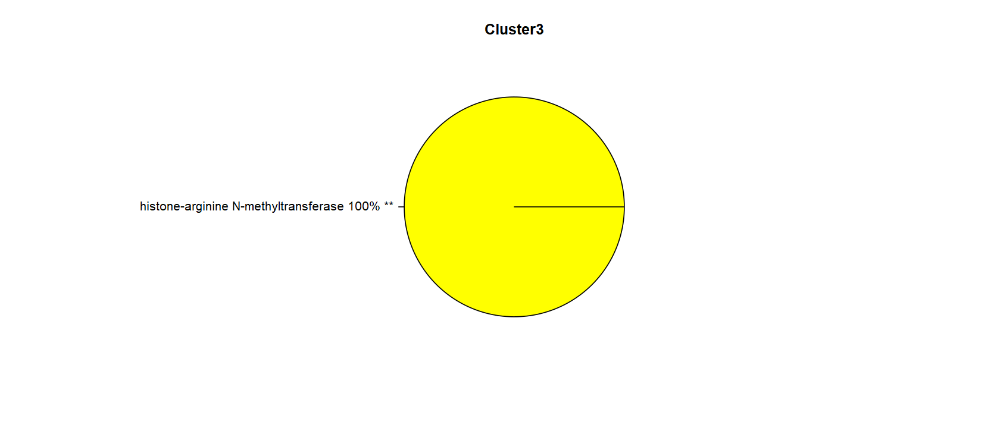

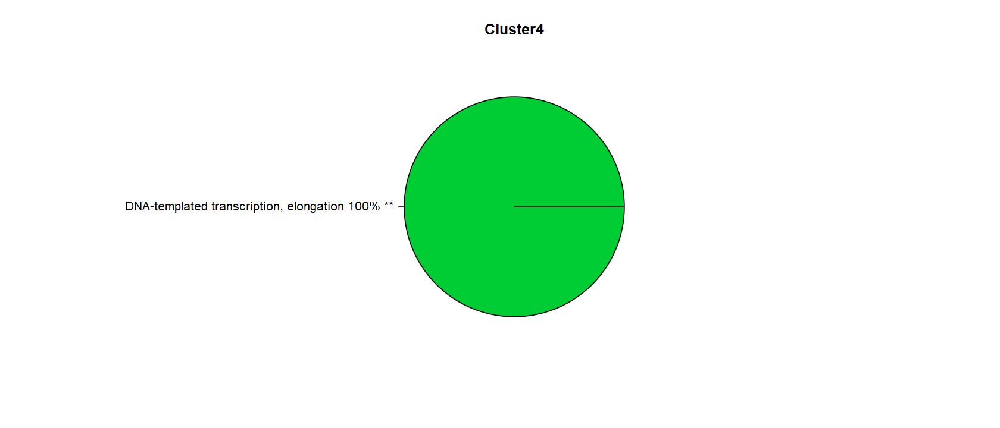

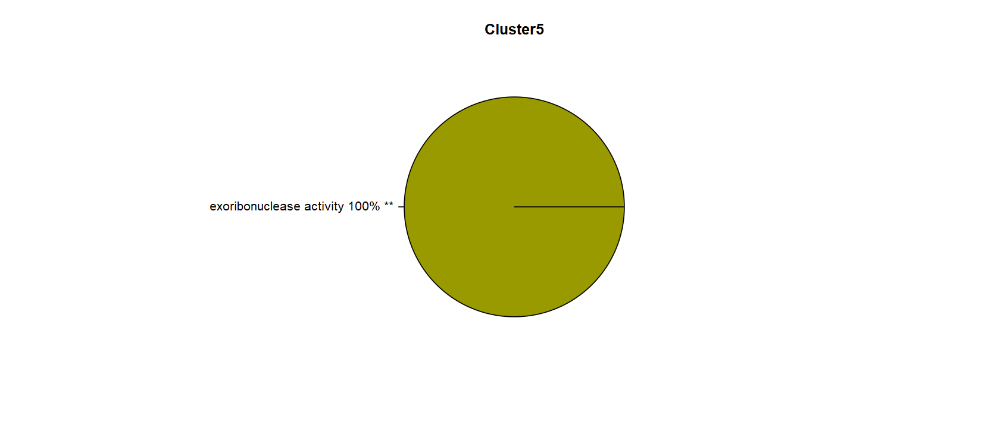

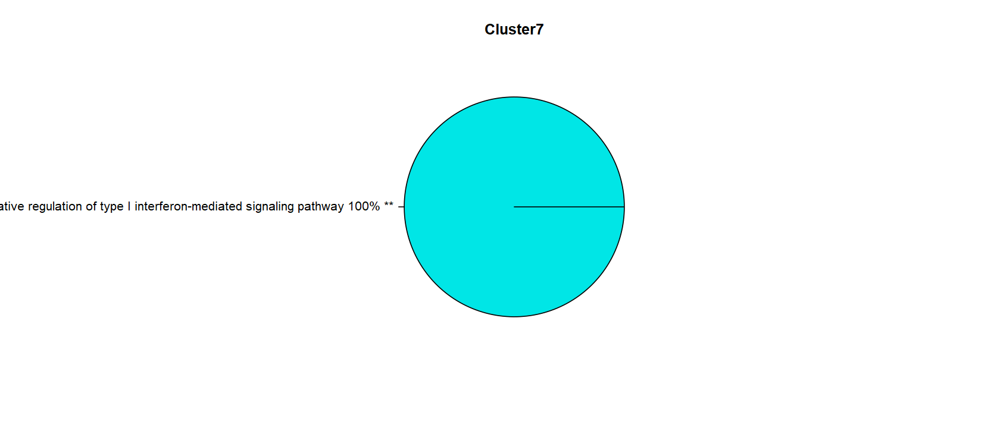

In [58]:
#绘图
library(RColorBrewer)

options(repr.plot.width=14, repr.plot.height=6)

p1 <- pie(cluster1$`Percent(%)`,
    labels = paste0(cluster1$`GO:BP`,' ',cluster1$`Percent(%)`,"%"," **"),
    col = rev(brewer.pal(13,"Reds")))+
title("Cluster1")

p2 <- pie(cluster2$`Percent(%)`,
    labels = paste0(cluster2$`GO:BP`,' ',cluster2$`Percent(%)`,"%"," **"),
    col = '#FF9900')+
title("Cluster2")

p3 <- pie(cluster3$`Percent(%)`,
    labels = paste0(cluster3$`GO:BP`,' ',cluster3$`Percent(%)`,"%"," **"),
    col = '#FFFF00')+
title("Cluster3")

p4 <- pie(cluster4$`Percent(%)`,
    labels = paste0(cluster4$`GO:BP`,' ',cluster4$`Percent(%)`,"%"," **"),
    col = '#00CC33')+
title("Cluster4")

p5 <- pie(cluster5$`Percent(%)`,
    labels = paste0(cluster5$`GO:BP`,' ',cluster5$`Percent(%)`,"%"," **"),
    col = '#999900')+
title("Cluster5")

p7 <- pie(cluster7$`Percent(%)`,
    labels = paste0(cluster7$`GO:BP`,' ',cluster7$`Percent(%)`,"%"," **"),
    col = '#00E6E6')+
title("Cluster7")

In [59]:
#存图
pdf(file = 'H:\\Bioinformatics\\1109STRING\\Output\\PiePlots.pdf',width=15, height=5)

p1 <- pie(cluster1$`Percent(%)`,
    labels = paste0(cluster1$`GO:BP`,' ',cluster1$`Percent(%)`,"%"," **"),
    col = rev(brewer.pal(13,"Reds")))+
title("Cluster1")

p2 <- pie(cluster2$`Percent(%)`,
    labels = paste0(cluster2$`GO:BP`,' ',cluster2$`Percent(%)`,"%"," **"),
    col = '#FF9900')+
title("Cluster2")

p3 <- pie(cluster3$`Percent(%)`,
    labels = paste0(cluster3$`GO:BP`,' ',cluster3$`Percent(%)`,"%"," **"),
    col = '#FFFF00')+
title("Cluster3")

p4 <- pie(cluster4$`Percent(%)`,
    labels = paste0(cluster4$`GO:BP`,' ',cluster4$`Percent(%)`,"%"," **"),
    col = '#00CC33')+
title("Cluster4")

p5 <- pie(cluster5$`Percent(%)`,
    labels = paste0(cluster5$`GO:BP`,' ',cluster5$`Percent(%)`,"%"," **"),
    col = '#999900')+
title("Cluster5")

p7 <- pie(cluster7$`Percent(%)`,
    labels = paste0(cluster7$`GO:BP`,' ',cluster7$`Percent(%)`,"%"," **"),
    col = '#00E6E6')+
title("Cluster7")
dev.off()

Warning message in brewer.pal(13, "Reds"):
"n too large, allowed maximum for palette Reds is 9
Returning the palette you asked for with that many colors
"


png 
  2

### 4. 结果
最后进行拼图，得到如下复现图：

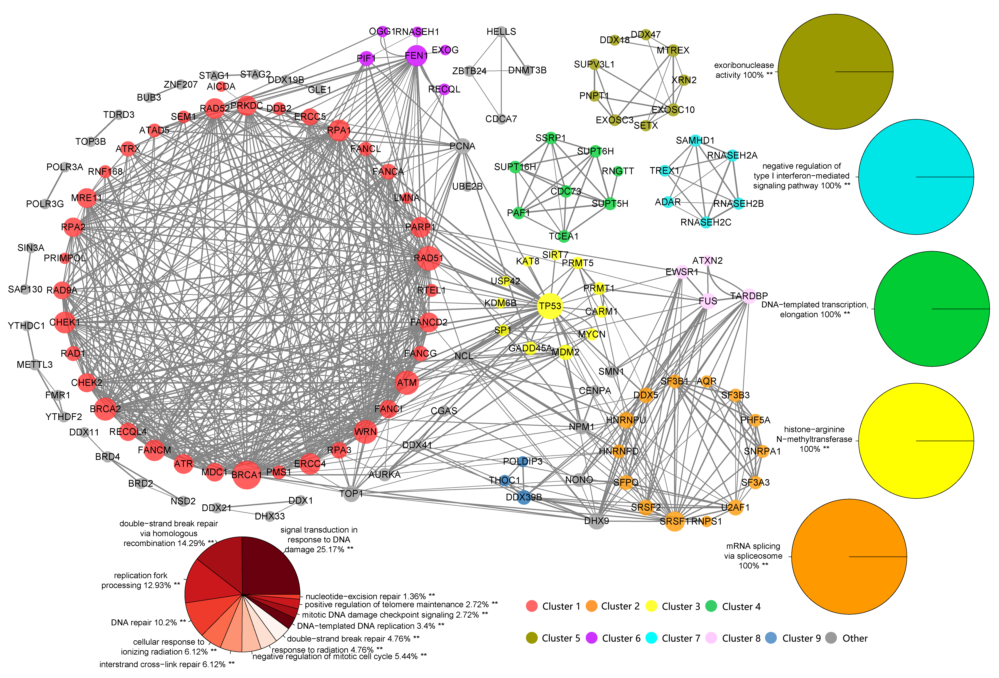